## PIL

In [1]:
import PIL

In [2]:
PIL.__version__

'7.1.2'

In [4]:
help(PIL) # shows documantation

Help on package PIL:

NAME
    PIL - Pillow (Fork of the Python Imaging Library)

DESCRIPTION
    Pillow is the friendly PIL fork by Alex Clark and Contributors.
        https://github.com/python-pillow/Pillow/
    
    Pillow is forked from PIL 1.1.7.
    
    PIL is the Python Imaging Library by Fredrik Lundh and Contributors.
    Copyright (c) 1999 by Secret Labs AB.
    
    Use PIL.__version__ for this Pillow version.
    
    ;-)

PACKAGE CONTENTS
    BdfFontFile
    BlpImagePlugin
    BmpImagePlugin
    BufrStubImagePlugin
    ContainerIO
    CurImagePlugin
    DcxImagePlugin
    DdsImagePlugin
    EpsImagePlugin
    ExifTags
    FitsStubImagePlugin
    FliImagePlugin
    FontFile
    FpxImagePlugin
    FtexImagePlugin
    GbrImagePlugin
    GdImageFile
    GifImagePlugin
    GimpGradientFile
    GimpPaletteFile
    GribStubImagePlugin
    Hdf5StubImagePlugin
    IcnsImagePlugin
    IcoImagePlugin
    ImImagePlugin
    Image
    ImageChops
    ImageCms
    ImageColor
    ImageDr

In [5]:
from PIL import Image

In [11]:
file = 'moin.png'
img = Image.open(file)
print(img) # 

<PIL.PngImagePlugin.PngImageFile image mode=RGB size=1065x1173 at 0x13BA3ABD048>


In [12]:
import inspect
print(type(img))
inspect.getmro(type(img)) # return a list of classes that inherited by this obj

<class 'PIL.PngImagePlugin.PngImageFile'>


(PIL.PngImagePlugin.PngImageFile,
 PIL.ImageFile.ImageFile,
 PIL.Image.Image,
 object)

In [13]:
img.show() # open in different window

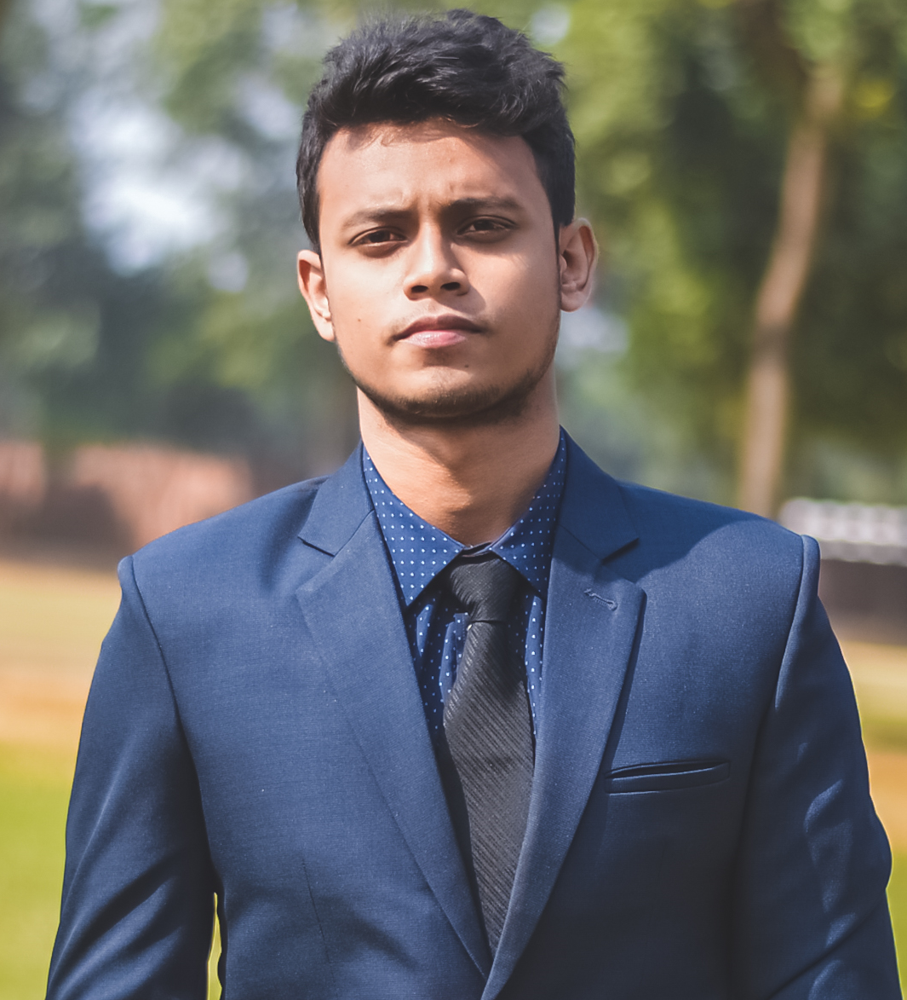

In [14]:
from IPython.display import display # jupyter function. can communicate with browser.
display(img) # open here

## PIL - copy function

In [15]:
help(img.copy)

Help on method copy in module PIL.Image:

copy() method of PIL.PngImagePlugin.PngImageFile instance
    Copies this image. Use this method if you wish to paste things
    into an image, but still retain the original.
    
    :rtype: :py:class:`~PIL.Image.Image`
    :returns: An :py:class:`~PIL.Image.Image` object.



In [18]:
file2 = 'sign.png'
c_img = Image.open(file2)
print(c_img)

<PIL.PngImagePlugin.PngImageFile image mode=RGBA size=1158x263 at 0x13BA3C22708>


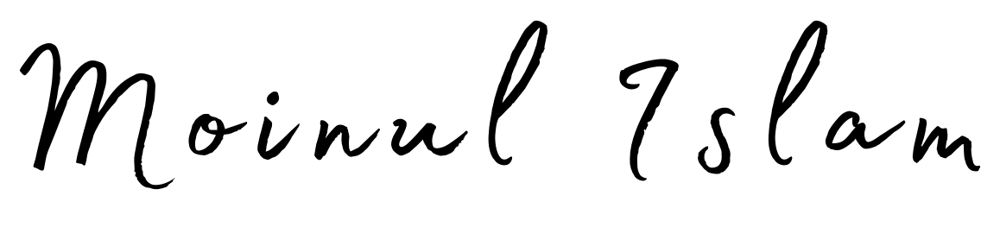

In [19]:
c_img.copy()

## PIL - save funtion

In [20]:
help(img.save)

Help on method save in module PIL.Image:

save(fp, format=None, **params) method of PIL.PngImagePlugin.PngImageFile instance
    Saves this image under the given filename.  If no format is
    specified, the format to use is determined from the filename
    extension, if possible.
    
    Keyword options can be used to provide additional instructions
    to the writer. If a writer doesn't recognise an option, it is
    silently ignored. The available options are described in the
    :doc:`image format documentation
    <../handbook/image-file-formats>` for each writer.
    
    You can use a file object instead of a filename. In this case,
    you must always specify the format. The file object must
    implement the ``seek``, ``tell``, and ``write``
    methods, and be opened in binary mode.
    
    :param fp: A filename (string), pathlib.Path object or file object.
    :param format: Optional format override.  If omitted, the
       format to use is determined from the filename ext

In [44]:
img.save('moin2.png') # the img already saved in img var that is going to be saved again
c_img.save('moin3.png') # the img already saved in c_img var that is going to be saved again

## PIL - filter funtion 

In [33]:
from PIL import ImageFilter

help(ImageFilter)

Help on module PIL.ImageFilter in PIL:

NAME
    PIL.ImageFilter

DESCRIPTION
    # The Python Imaging Library.
    # $Id$
    #
    # standard filters
    #
    # History:
    # 1995-11-27 fl   Created
    # 2002-06-08 fl   Added rank and mode filters
    # 2003-09-15 fl   Fixed rank calculation in rank filter; added expand call
    #
    # Copyright (c) 1997-2003 by Secret Labs AB.
    # Copyright (c) 1995-2002 by Fredrik Lundh.
    #
    # See the README file for information on usage and redistribution.
    #

CLASSES
    builtins.object
        Filter
            ModeFilter
            MultibandFilter
                BoxBlur
                BuiltinFilter
                    BLUR
                    CONTOUR
                    DETAIL
                    EDGE_ENHANCE
                    EDGE_ENHANCE_MORE
                    EMBOSS
                    FIND_EDGES
                    Kernel
                    SHARPEN
                    SMOOTH
                    SMOOTH_MORE
          

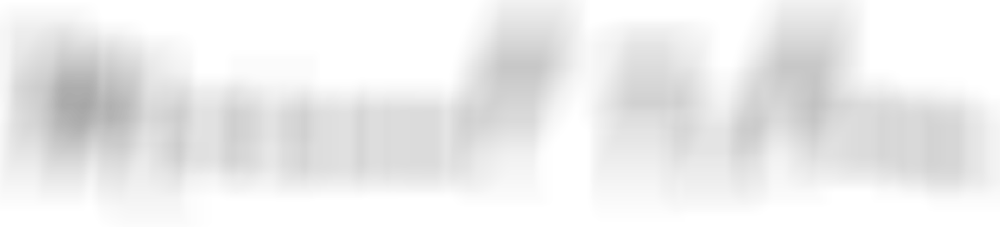

In [45]:
blur_img = c_img.filter(PIL.ImageFilter.BoxBlur(50))
display(blur_img)

In [52]:
blur_img2 = c_img.filter(PIL.ImageFilter.Color3DLUT(5,'channels'))
display(blur_img2)

ValueError: The table should have either channels * size**3 float items or size**3 items of channels-sized tuples with floats. Table should be: 3x5x5x5. Actual length: 8

## PIL - crop function

In [56]:
print("{}x{}".format(img.width, img.height))

1065x1173


In [57]:
help(img.crop)

Help on method crop in module PIL.Image:

crop(box=None) method of PIL.PngImagePlugin.PngImageFile instance
    Returns a rectangular region from this image. The box is a
    4-tuple defining the left, upper, right, and lower pixel
    coordinate. See :ref:`coordinate-system`.
    
    Note: Prior to Pillow 3.4.0, this was a lazy operation.
    
    :param box: The crop rectangle, as a (left, upper, right, lower)-tuple.
    :rtype: :py:class:`~PIL.Image.Image`
    :returns: An :py:class:`~PIL.Image.Image` object.



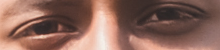

In [129]:
display(img.crop((400,250,620,300)))

## PIL - draw function

In [131]:
from PIL import ImageDraw
help(ImageDraw)

Help on module PIL.ImageDraw in PIL:

NAME
    PIL.ImageDraw

DESCRIPTION
    # The Python Imaging Library
    # $Id$
    #
    # drawing interface operations
    #
    # History:
    # 1996-04-13 fl   Created (experimental)
    # 1996-08-07 fl   Filled polygons, ellipses.
    # 1996-08-13 fl   Added text support
    # 1998-06-28 fl   Handle I and F images
    # 1998-12-29 fl   Added arc; use arc primitive to draw ellipses
    # 1999-01-10 fl   Added shape stuff (experimental)
    # 1999-02-06 fl   Added bitmap support
    # 1999-02-11 fl   Changed all primitives to take options
    # 1999-02-20 fl   Fixed backwards compatibility
    # 2000-10-12 fl   Copy on write, when necessary
    # 2001-02-18 fl   Use default ink for bitmap/text also in fill mode
    # 2002-10-24 fl   Added support for CSS-style color strings
    # 2002-12-10 fl   Added experimental support for RGBA-on-RGB drawing
    # 2002-12-11 fl   Refactored low-level drawing API (work in progress)
    # 2004-08-26 fl   Made 

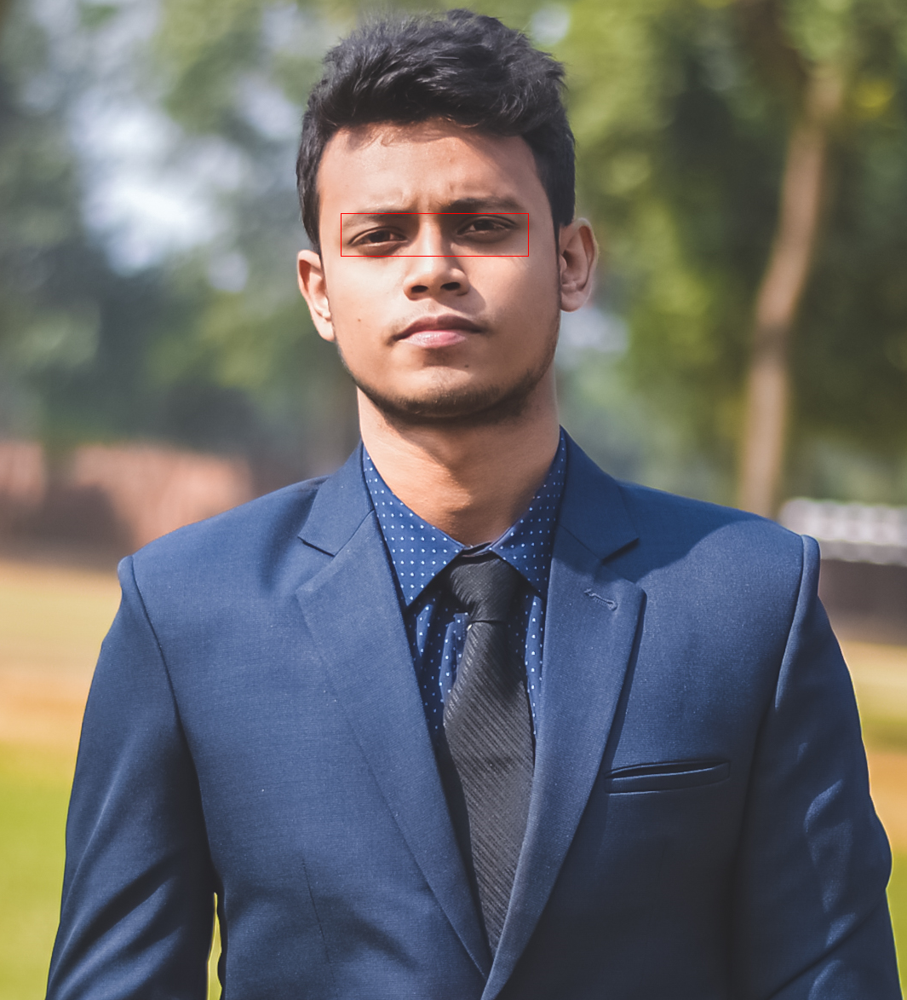

In [134]:
obj_draw = ImageDraw.Draw(img)
obj_draw.rectangle((400,250,620,300), outline = 'red')
display(img)

## PIL - convert function

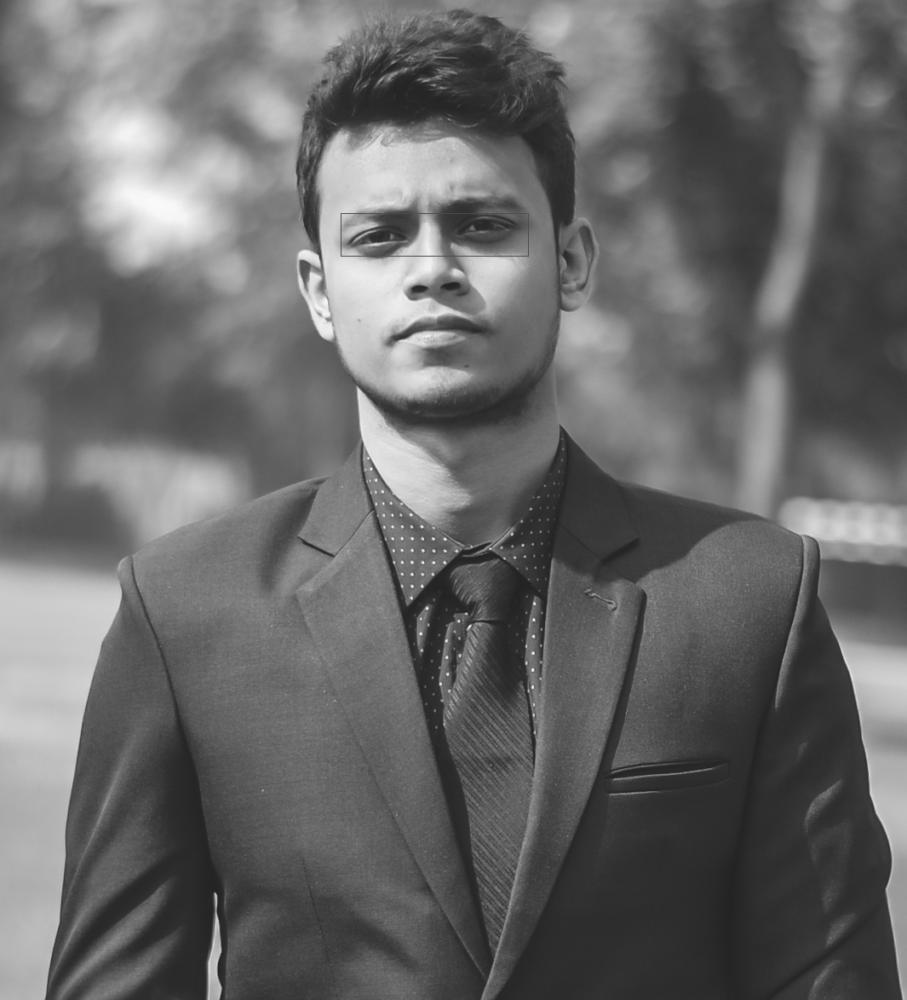

In [139]:
display(img.convert('L'))

In [138]:
help(img.convert)

Help on method convert in module PIL.Image:

convert(mode=None, matrix=None, dither=None, palette=0, colors=256) method of PIL.PngImagePlugin.PngImageFile instance
    Returns a converted copy of this image. For the "P" mode, this
    method translates pixels through the palette.  If mode is
    omitted, a mode is chosen so that all information in the image
    and the palette can be represented without a palette.
    
    The current version supports all possible conversions between
    "L", "RGB" and "CMYK." The **matrix** argument only supports "L"
    and "RGB".
    
    When translating a color image to greyscale (mode "L"),
    the library uses the ITU-R 601-2 luma transform::
    
        L = R * 299/1000 + G * 587/1000 + B * 114/1000
    
    The default method of converting a greyscale ("L") or "RGB"
    image into a bilevel (mode "1") image uses Floyd-Steinberg
    dither to approximate the original image luminosity levels. If
    dither is NONE, all values larger than 128 ar

# ASSIGNMENT 1

In [5]:
pytesseract.pytesseract.tesseract_cmd = r'C:\Program Files\Tesseract-OCR\tesseract.exe'

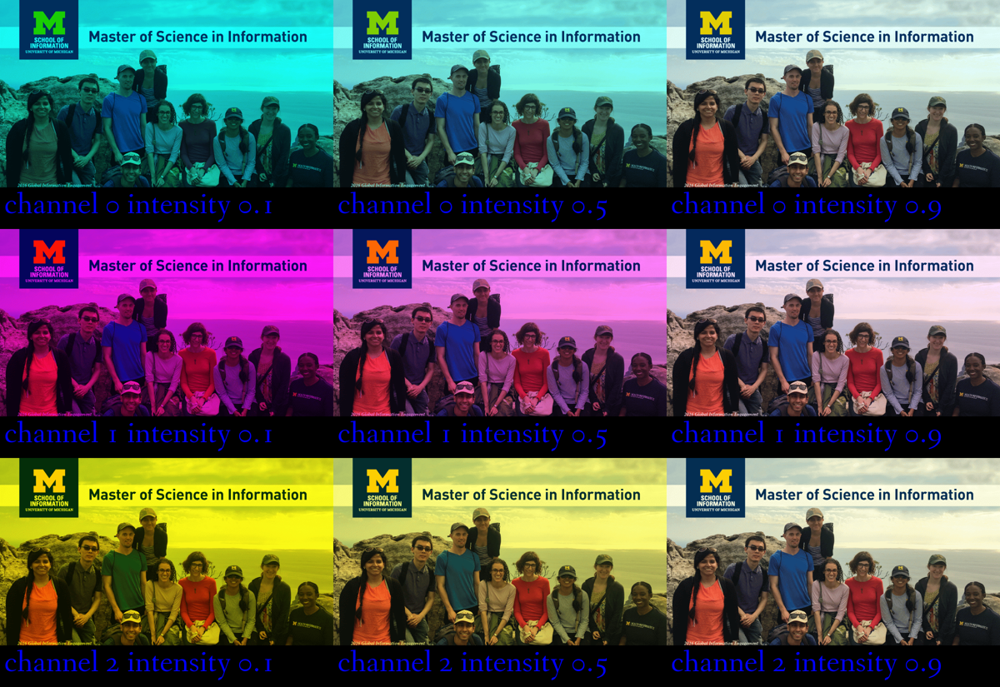

In [6]:
import PIL
from PIL import Image
from PIL import ImageDraw
from PIL import ImageFont
from IPython.display import display

# read image and convert to RGB
image = Image.open("msi_recruitment.gif")
image = image.convert('RGB')

width, height = image.size

newImg = PIL.Image.new(image.mode, (width, (height + 100)))
newImg.paste(image, (0, 0))


def draw_Text(c, i,img):
    text = "channel {} intensity {}".format(c, i)
    font = ImageFont.truetype(r'fanwood-webfont.ttf', 75)  
    Draw = ImageDraw.Draw(img)
    Draw.text((10,460), text, fill = "blue", font = font, align = "left") 
    

def set_Intensity(intensity, img, color):
    new = PIL.Image.new(img.mode, (newImg.width, newImg.height))

    for row in range(height):
        for col in range(width):
            save = img.getpixel((col, row))
            
            if color == 0:
                new.putpixel((col, row), (int(save[0] * intensity),save[1],save[2]))
                
            elif color == 1:
                new.putpixel((col, row), (save[0],int(save[1] * intensity),save[2]))    
                
            elif color == 2:
                new.putpixel((col, row), (save[0],save[1],int(save[2] * intensity)))    
    return new

intensity = [0.1, 0.5, 0.9]
colors = [0,1,2] 
images = []

for c in colors:
    for z in intensity:
        images.append(set_Intensity(z,newImg,c))
        draw_Text(c,z,images[-1])

contact_sheet = PIL.Image.new(newImg.mode, (newImg.width*3,(newImg.height)*3))
x = 0
y = 0

for img in images:
    contact_sheet.paste(img, (x, y) )

    if x+newImg.width == contact_sheet.width:
        x = 0
        y = y + newImg.height
    else:
        x = x + newImg.width

# resize and display the contact sheet
contact_sheet = contact_sheet.resize((int(contact_sheet.width/2),int(contact_sheet.height/2) ))
display(contact_sheet)

# WEEK 2 - TESSERACT LIBRARY 

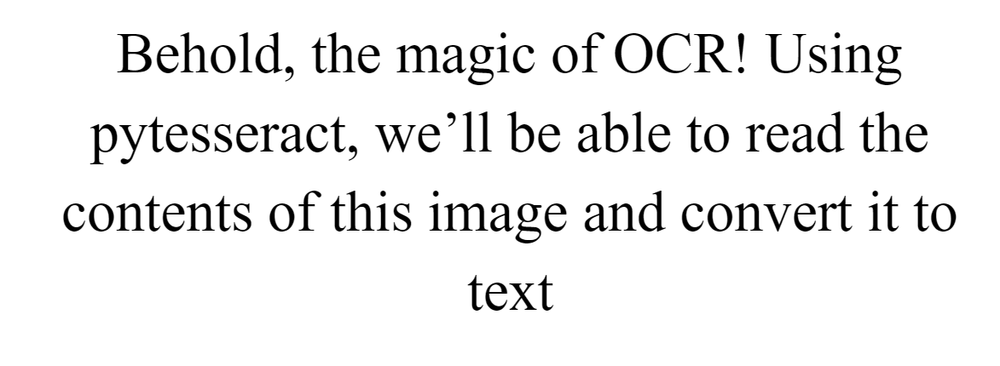

In [18]:
img = Image.open('text.png')
display(img)

In [3]:
import pytesseract

import PIL
from PIL import Image
import inspect
src = inspect.getsource(pytesseract.image_to_string)
print(src)

def image_to_string(
    image,
    lang=None,
    config='',
    nice=0,
    output_type=Output.STRING,
    timeout=0,
):
    """
    Returns the result of a Tesseract OCR run on the provided image to string
    """
    args = [image, 'txt', lang, config, nice, timeout]

    return {
        Output.BYTES: lambda: run_and_get_output(*(args + [True])),
        Output.DICT: lambda: {'text': run_and_get_output(*args)},
        Output.STRING: lambda: run_and_get_output(*args),
    }[output_type]()



In [1]:
conda install -c conda-forge pytesseract


Note: you may need to restart the kernel to use updated packages.

Solving environment: ...working... done

## Package Plan ##

  environment location: C:\ProgramData\Anaconda3

  added / updated specs:
    - pytesseract


The following NEW packages will be INSTALLED:

  pytesseract        conda-forge/noarch::pytesseract-0.3.7-pyhd3deb0d_0
  python_abi         conda-forge/win-64::python_abi-3.8-1_cp38

The following packages will be SUPERSEDED by a higher-priority channel:

  conda               pkgs/main::conda-4.9.2-py38haa95532_0 --> conda-forge::conda-4.9.2-py38haa244fe_0


Preparing transaction: ...working... done
Verifying transaction: ...working... done
Executing transaction: ...working... done


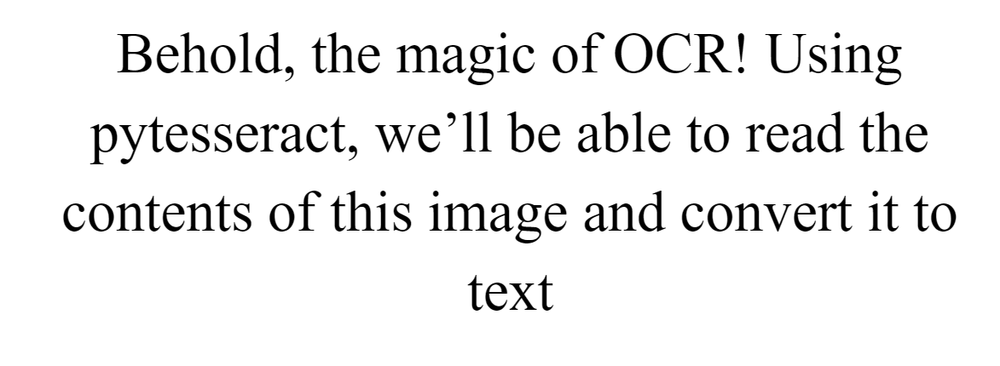

In [6]:
img = Image.open('text.png')
display(img)

In [7]:

text = pytesseract.image_to_string(img)
print(text)

Behold, the magic of OCR! Using
pytesseract, we’ll be able to read the
contents of this image and convert it to
text



noisy img

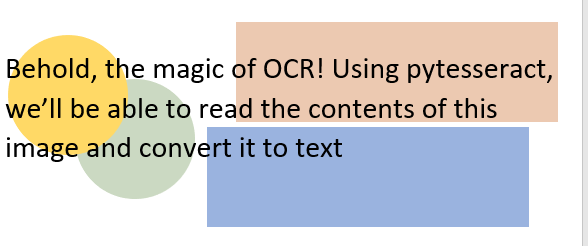

In [8]:
import PIL
from PIL import Image
img = Image.open('Noisy.png')
display(img)

In [10]:
txt = pytesseract.image_to_string(img)
print(txt)

e magic of OCR! Using pytesseract,
le to read the contents of this

 

d convert it to text



resize 

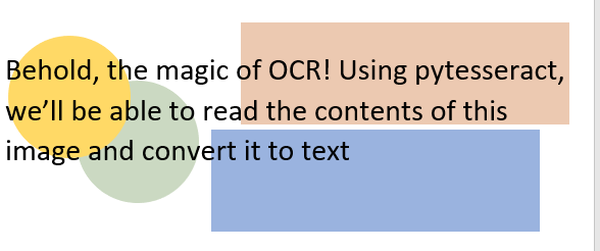

FileNotFoundError: [Errno 2] No such file or directory: 'resized_nois.png'

In [15]:
# First we will import PIL
import PIL 
# Then set the base width of our image
basewidth = 600 

# Now lets open it
img = Image.open("Noisy.png")

# We want to get the correct aspect ratio, so we can do this by taking the base width and dividing
# it by the actual width of the image
wpercent = (basewidth / float(img.size[0]))

# With that ratio we can just get the appropriate height of the image.
hsize = int((float(img.size[1]) * float(wpercent)))

# Finally, lets resize the image. antialiasing is a specific way of resizing lines to try and make them 
# appear smooth
img = img.resize((basewidth, hsize), PIL.Image.ANTIALIAS)

# Now lets save this to a file
img.save('resized_noise.png') # save the image as a jpg

# And finally, lets display it
display(img)

# and run OCR
text = pytesseract.image_to_string(Image.open('resized_nois.png')) 
print(text)

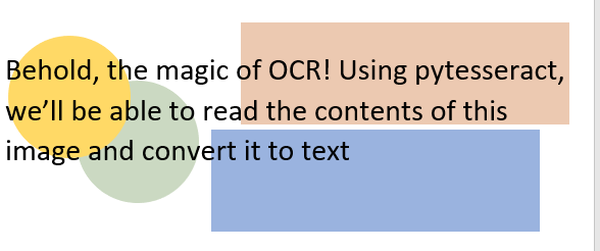

In [16]:
display(img)

gray scale 

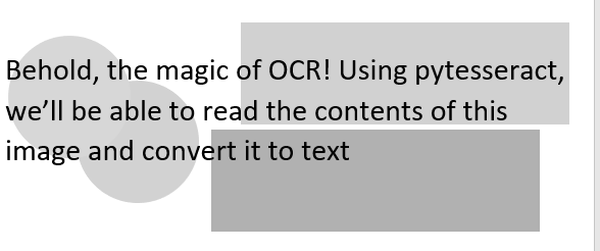

Behold, the magic of OCR! Using pytesseract,
we'll be able to read the contents of this
image and convert it to text



In [19]:
img = img.convert('L')
img.save('noise_gray.png')
display(img)
txt = pytesseract.image_to_string(Image.open('noise_gray.png'))
print(txt)

binarization

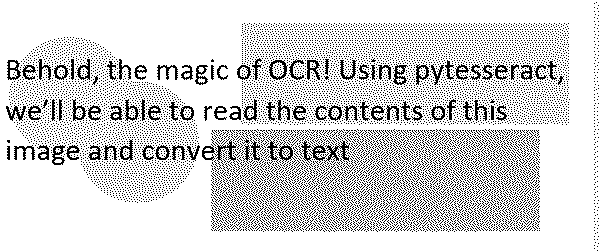

Behold, the magic of OCR! Using pytesseract,
we'll be able to read the contents of this

 



In [20]:
img = img.convert('1')
img.save('noise_black_white.png')
display(img)
text = pytesseract.image_to_string(Image.open('noise_black_white.png')) 
print(text)

Trying with threshold 0


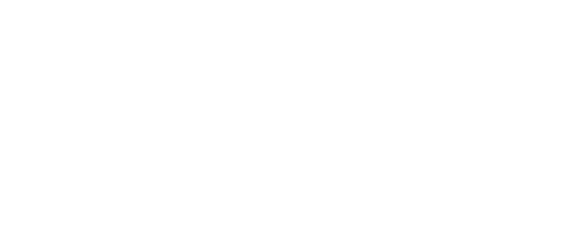


Trying with threshold 64


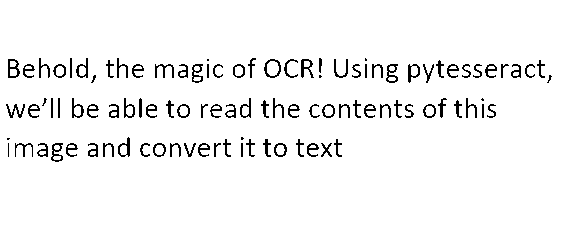

Behold, the magic of OCR! Using pytesseract,
we’ll be able to read the contents of this
image and convert it to text

Trying with threshold 128


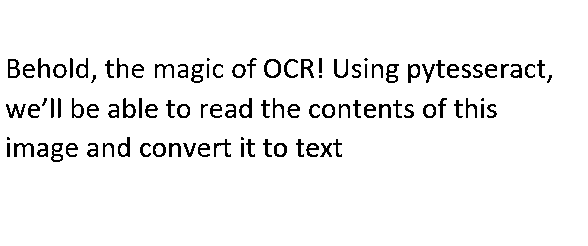

Behold, the magic of OCR! Using pytesseract,
we'll be able to read the contents of this
image and convert it to text

Trying with threshold 192


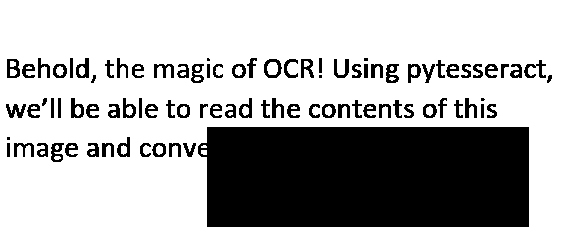

Behold, the magic of OCR! Using pytesseract,
we’ll be able to read the contents of this
image and conv

 
 

Trying with threshold 256


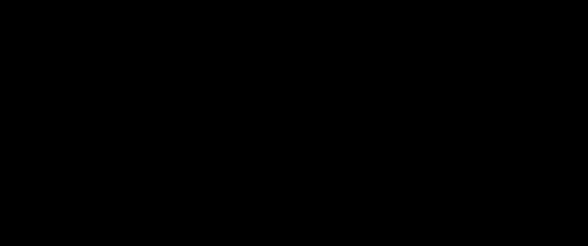

In [22]:
# So, that was a bit magical, and really required a fine reading of the docs to figure out
# that the number "1" is a string parameter to the convert function actually does the binarization.
# But you actually have all of the skills you need to write this functionality yourself.
# Lets walk through an example. First, lets define a function called binarize, which takes in
# an image and a threshold value:
def binarize(image_to_transform, threshold):
    # now, lets convert that image to a single greyscale image using convert()
    output_image=image_to_transform.convert("L")
    # the threshold value is usually provided as a number between 0 and 255, which
    # is the number of bits in a byte.
    # the algorithm for the binarization is pretty simple, go through every pixel in the
    # image and, if it's greater than the threshold, turn it all the way up (255), and
    # if it's lower than the threshold, turn it all the way down (0).
    # so lets write this in code. First, we need to iterate over all of the pixels in the
    # image we want to work with
    for x in range(output_image.width):
        for y in range(output_image.height):
            # for the given pixel at w,h, lets check its value against the threshold
            if output_image.getpixel((x,y))< threshold: #note that the first parameter is actually a tuple object
                # lets set this to zero
                output_image.putpixel( (x,y), 0 )
            else:
                # otherwise lets set this to 255
                output_image.putpixel( (x,y), 255 )
    #now we just return the new image
    return output_image

# lets test this function over a range of different thresholds. Remember that you can use
# the range() function to generate a list of numbers at different step sizes. range() is called
# with a start, a stop, and a step size. So lets try range(0, 257, 64), which should generate 5
# images of different threshold values
for thresh in range(0,257,64):
    print("Trying with threshold " + str(thresh))
    # Lets display the binarized image inline
    display(binarize(Image.open('Noisy.png'), thresh))
    # And lets use tesseract on it. It's inefficient to binarize it twice but this is just for
    # a demo
    print(pytesseract.image_to_string(binarize(Image.open('Noisy.png'), thresh)))

fossil img

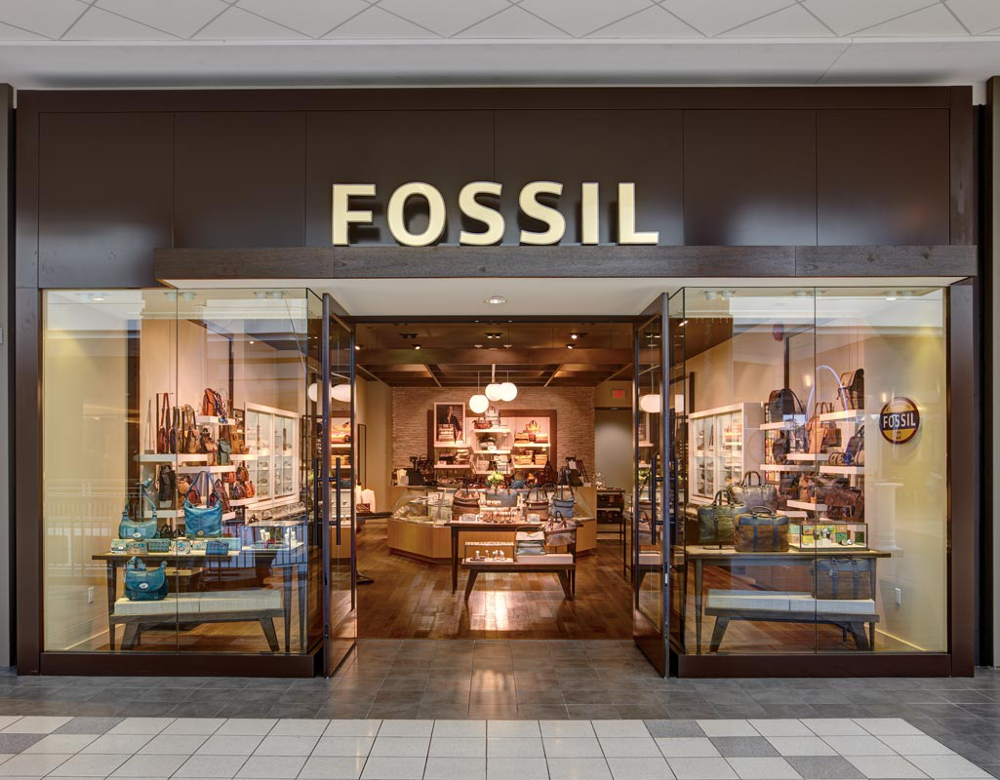

In [30]:
img = Image.open('fossil.jpg')
display(img)
txt = pytesseract.image_to_string(img)
print(txt) # cant find as the img is too big

crop it

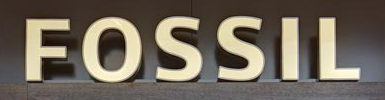

In [31]:
bounding_box = (315,170,700,270)
a = img.crop(bounding_box)
display(a)

txt = pytesseract.image_to_string(img) # now it will work
print(txt)

working with the logo 

In [38]:
bounding_box = (900,420,940,445)
little_img = img.crop(bounding_box)
display(little_img)

txt = pytesseract.image_to_string(little_img)  # cant find the logo
print(txt)

FOSSIL



resize it 

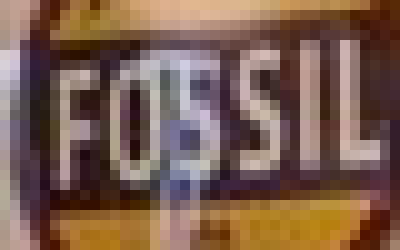

 FOBSIL



In [40]:
new_size = (little_img.width * 10, little_img.height*10) 
check1 = little_img.resize(new_size, Image.NEAREST)
display(check1) # Image.NEAREST is the default resizing value

txt = pytesseract.image_to_string(check1)  # cant find the logo
print(txt)

0


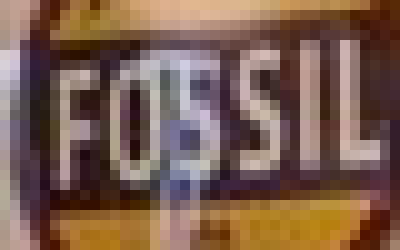

 FOBSIL

4


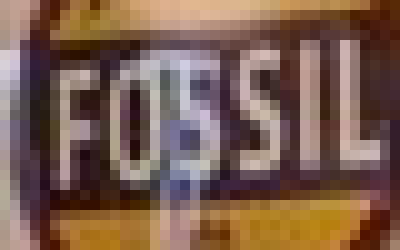

 FOBSIL

2


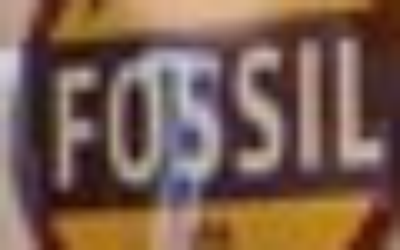


5


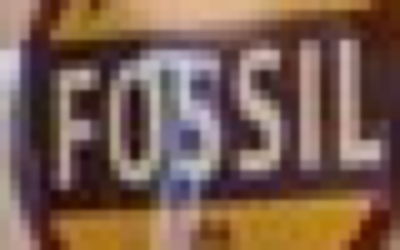

 FOBSIL

3


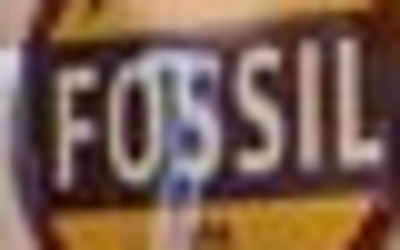


1


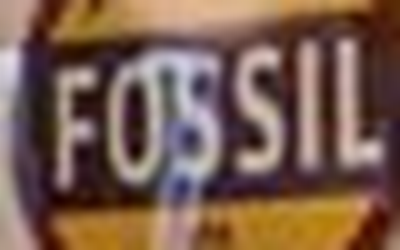

 FORSIL



In [42]:
options=[Image.NEAREST, Image.BOX, Image.BILINEAR, Image.HAMMING, Image.BICUBIC, Image.LANCZOS]

for option in options:
    print(option)
    z = little_img.resize(new_size, option)
    display(z)
    txt = pytesseract.image_to_string(z)  # cant find the logo
    print(txt)

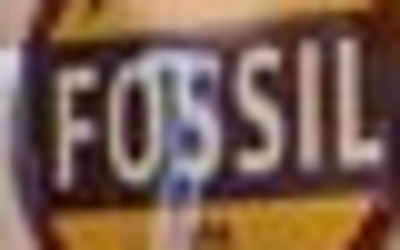

'\x0c'

In [46]:
# From this we can notice two things. First, when we print out one of the resampling
# values it actually just prints an integer! This is really common: that the
# API developer writes a property, such as Image.BICUBIC, and then assigns it to an
# integer value to pass it around. Some languages use enumerations of values, which is
# common in say, Java, but in python this is a pretty normal way of doing things.
# The second thing we learned is that there are a number of different algorithms for
# image resampling. In this case, the Image.LANCZOS and Image.BICUBIC filters do a good
# job. Lets see if we are able to recognize the text off of this resized image

# First lets resize to the larger size
bigger_sign=little_img.resize(new_size, Image.BICUBIC)
display(bigger_sign)
# Lets print out the text
pytesseract.image_to_string(bigger_sign)

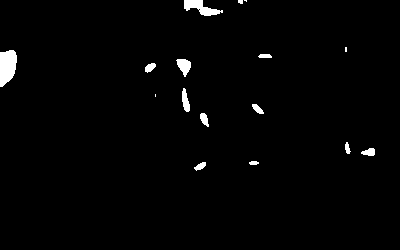

'Va\n\x0c'

In [47]:
# Well, no text there. Lets try and binarize this. First, let me just bring in the
# binarization code we did earlier
def binarize(image_to_transform, threshold):
    output_image=image_to_transform.convert("L")
    for x in range(output_image.width):
        for y in range(output_image.height):
            if output_image.getpixel((x,y))< threshold:
                output_image.putpixel( (x,y), 0 )
            else:
                output_image.putpixel( (x,y), 255 )
    return output_image

# Now, lets apply binarizations with, say, a threshold of 190, and try and display that
# as well as do the OCR work
binarized_bigger_sign=binarize(bigger_sign, 190)
display(binarized_bigger_sign)
pytesseract.image_to_string(binarized_bigger_sign)

In [48]:
# Ok, that text is pretty useless. How should we pick the best binarization
# to use? Well, there are some methods, but lets just try something very simple to
# show how well this can work. We have an english word we are trying to detect, "FOSSIL".
# If we tried all binarizations, from 0 through 255, and looked to see if there were
# any english words in that list, this might be one way. So lets see if we can
# write a routine to do this.
#
# First, lets load a list of english words into a list. I put a copy in the readonly
# directory for you to work with
eng_dict=[]
with open ("words_alpha.txt", "r") as f:
    data=f.read()
    # now we want to split this into a list based on the new line characters
    eng_dict=data.split("\n")

# Now lets iterate through all possible thresholds and look for an english word, printing
# it out if it exists
for i in range(150,170):
    # lets binarize and convert this to s tring values
    strng=pytesseract.image_to_string(binarize(bigger_sign,i))
    # We want to remove non alphabetical characters, like ([%$]) from the text, here's
    # a short method to do that
    # first, lets convert our string to lower case only
    strng=strng.lower()
    # then lets import the string package - it has a nice list of lower case letters
    import string
    # now lets iterate over our string looking at it character by character, putting it in
    # the comaprison text
    comparison=''
    for character in strng:
        if character in string.ascii_lowercase:
            comparison=comparison+character
    # finally, lets search for comparison in the dictionary file
    if comparison in eng_dict:
        # and print it if we find it
        print(comparison)

gas
gas
fossil
fossil


trying random photo

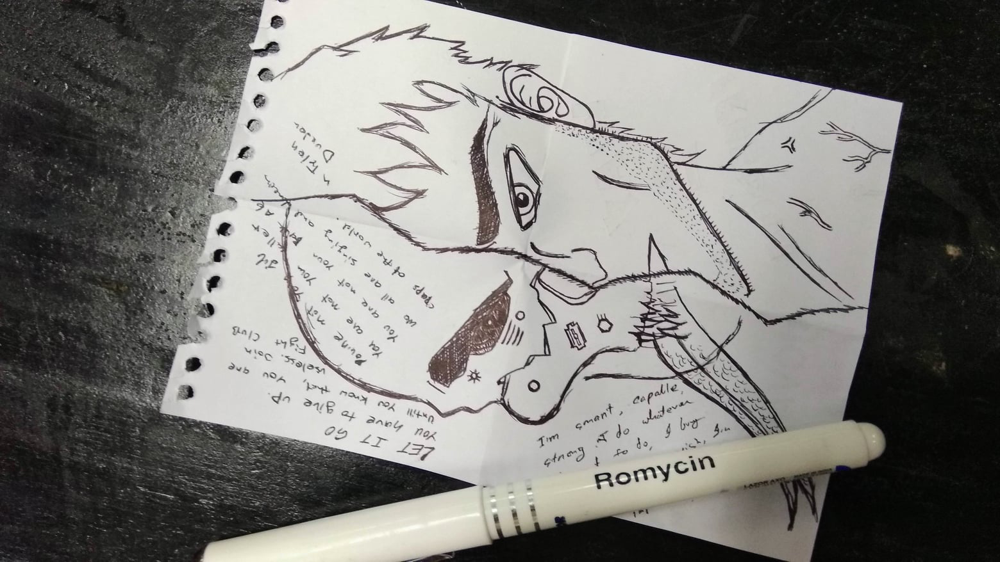

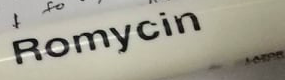

Romy cin a



In [59]:
img = Image.open('rifat2.jpg')
display(img)
txt = pytesseract.image_to_string(img)
print(txt) # cant find as the img is too big

bounding_box = (915,700,1200,780)
little_img = img.crop(bounding_box)
display(little_img)
4
txt = pytesseract.image_to_string(little_img) # now it will work
print(txt)

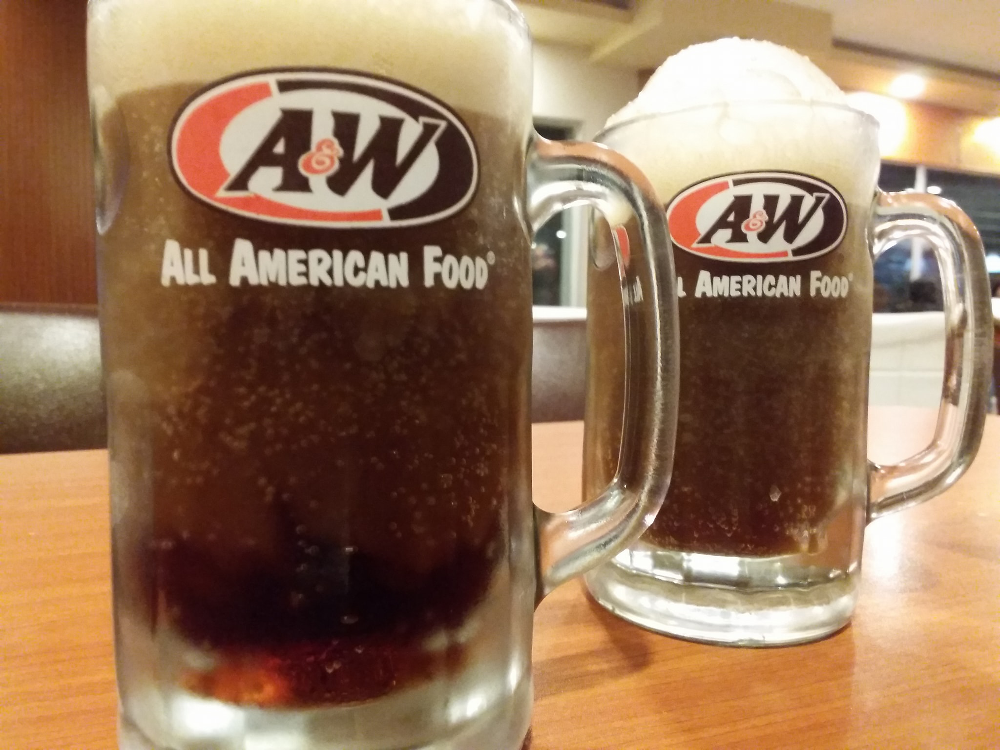

   

{

\
Au AMERICAN Foo’ *

ar \ AMERICAN Foo 7

    

 



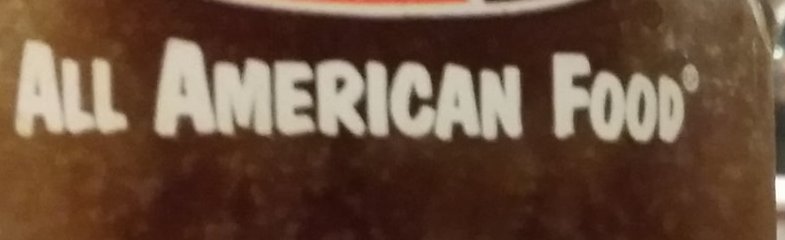

ALL AMERICAN Foon’



In [87]:
img = Image.open('moin1.jpg')
display(img)
txt = pytesseract.image_to_string(img)
print(txt) # cant find as the img is too big


bounding_box = (315,450,1100,690)
little_img = img.crop(bounding_box)
display(little_img)
4
txt = pytesseract.image_to_string(little_img) # now it will work
print(txt)

# JUPYTER WIDGETS

In [88]:
# In this brief lecture I want to introduce you to one of the more advanced features of the 
# Jupyter notebook development environment called widgets. Sometimes you want
# to interact with a function you have created and call it multiple times with different
# parameters. For instance, if we wanted to draw a red box around a portion of an
# image to try and fine tune the crop location. Widgets are one way to do this quickly
# in the browser without having to learn how to write a large desktop application.
#
# Lets check it out. First we want to import the Image and ImageDraw classes from the
# PILLOW package
from PIL import Image, ImageDraw

# Then we want to import the interact class from the widgets package
from ipywidgets import interact

# We will use interact to annotate a function. Lets bring in an image that we know we 
# are interested in, like the storefront image from a previous lecture
image=Image.open('fossil.jpg')

# Ok, our setup is done. Now we're going to use the interact decorator to indicate
# that we want to wrap the python function. We do this using the @ sign. This will
# take a set of parameters which are identical to the function to be called. Then Jupyter
# will draw some sliders on the screen to let us manipulate these values. Decorators,
# which is what the @ sign is describing, are standard python statements and just a
# short hand for functions which wrap other functions. They are a bit advanced though, so
# we haven't talked about them in this course, and you might just have to have some faith
@interact(left=100, top=100, right=200, bottom=200)

# Now we just write the function we had before
def draw_border(left, top, right, bottom):
    img=image.copy()
    drawing_object=ImageDraw.Draw(img)
    drawing_object.rectangle((left,top,right,bottom), fill = None, outline ='red')
    display(img)

interactive(children=(IntSlider(value=100, description='left', max=300, min=-100), IntSlider(value=100, descri…

KRAKEN

In [2]:
# First, we'll take a look at the kraken module itself
import kraken
help(kraken)

Help on package kraken:

NAME
    kraken - entry point for kraken functionality

PACKAGE CONTENTS
    binarization
    ketos
    kraken
    lib (package)
    linegen
    pageseg
    repo
    rpred
    serialization
    transcribe

DATA
    absolute_import = _Feature((2, 5, 0, 'alpha', 1), (3, 0, 0, 'alpha', 0...
    division = _Feature((2, 2, 0, 'alpha', 2), (3, 0, 0, 'alpha', 0), 1310...
    print_function = _Feature((2, 6, 0, 'alpha', 2), (3, 0, 0, 'alpha', 0)...

FILE
    c:\programdata\anaconda3\lib\site-packages\kraken\__init__.py




In [10]:
# First, we'll take a look at the kraken module itself
import kraken
help(kraken)

Help on package kraken:

NAME
    kraken - entry point for kraken functionality

PACKAGE CONTENTS
    binarization
    ketos
    kraken
    lib (package)
    linegen
    pageseg
    repo
    rpred
    serialization
    transcribe

DATA
    absolute_import = _Feature((2, 5, 0, 'alpha', 1), (3, 0, 0, 'alpha', 0...
    division = _Feature((2, 2, 0, 'alpha', 2), (3, 0, 0, 'alpha', 0), 1310...
    print_function = _Feature((2, 6, 0, 'alpha', 2), (3, 0, 0, 'alpha', 0)...

FILE
    c:\programdata\anaconda3\lib\site-packages\kraken\__init__.py




The Project
This is a project with minimal scaffolding. Expect to use the the discussion forums to gain insights! It’s not cheating to ask others for opinions or perspectives!
Be inquisitive, try out new things.
Use the previous modules for insights into how to complete the functions! You'll have to combine Pillow, OpenCV, and Pytesseract
There are hints provided in Coursera, feel free to explore the hints if needed. Each hint provide progressively more details on how to solve the issue. This project is intended to be comprehensive and difficult if you do it without the hints.
The Assignment
Take a ZIP file of images and process them, using a library built into python that you need to learn how to use. A ZIP file takes several different files and compresses them, thus saving space, into one single file. The files in the ZIP file we provide are newspaper images (like you saw in week 3). Your task is to write python code which allows one to search through the images looking for the occurrences of keywords and faces. E.g. if you search for "pizza" it will return a contact sheet of all of the faces which were located on the newspaper page which mentions "pizza". This will test your ability to learn a new (library), your ability to use OpenCV to detect faces, your ability to use tesseract to do optical character recognition, and your ability to use PIL to composite images together into contact sheets.

Each page of the newspapers is saved as a single PNG image in a file called images.zip. These newspapers are in english, and contain a variety of stories, advertisements and images. Note: This file is fairly large (~200 MB) and may take some time to work with, I would encourage you to use small_img.zip for testing.

Here's an example of the output expected. Using the small_img.zip file, if I search for the string "Christopher" I should see the following image:

In [2]:
import math
import zipfile
from PIL import Image, ImageOps, ImageDraw
import pytesseract
import cv2 as cv
import numpy as np

# loading the face detection classifier
face_cascade = cv.CascadeClassifier('haarcascade_frontalface_default.xml')

# the rest is up to you!

In [25]:
#define a parsed source to work on:
parsed_img_src = {}

In [26]:
#iterate through the zip file and save all the binarized versions to parsed_img_src
with zipfile.ZipFile('small_img.zip', 'r') as archive:
    for entry in archive.infolist():
        with archive.open(entry) as file:
            img = Image.open(file).convert('RGB')
            parsed_img_src[entry.filename] = {'pil_img':img}

In [27]:
#parse all images text
for img_name in parsed_img_src.keys():
    text = pytesseract.image_to_string(parsed_img_src[img_name]['pil_img'])
    parsed_img_src[img_name]['text'] = text

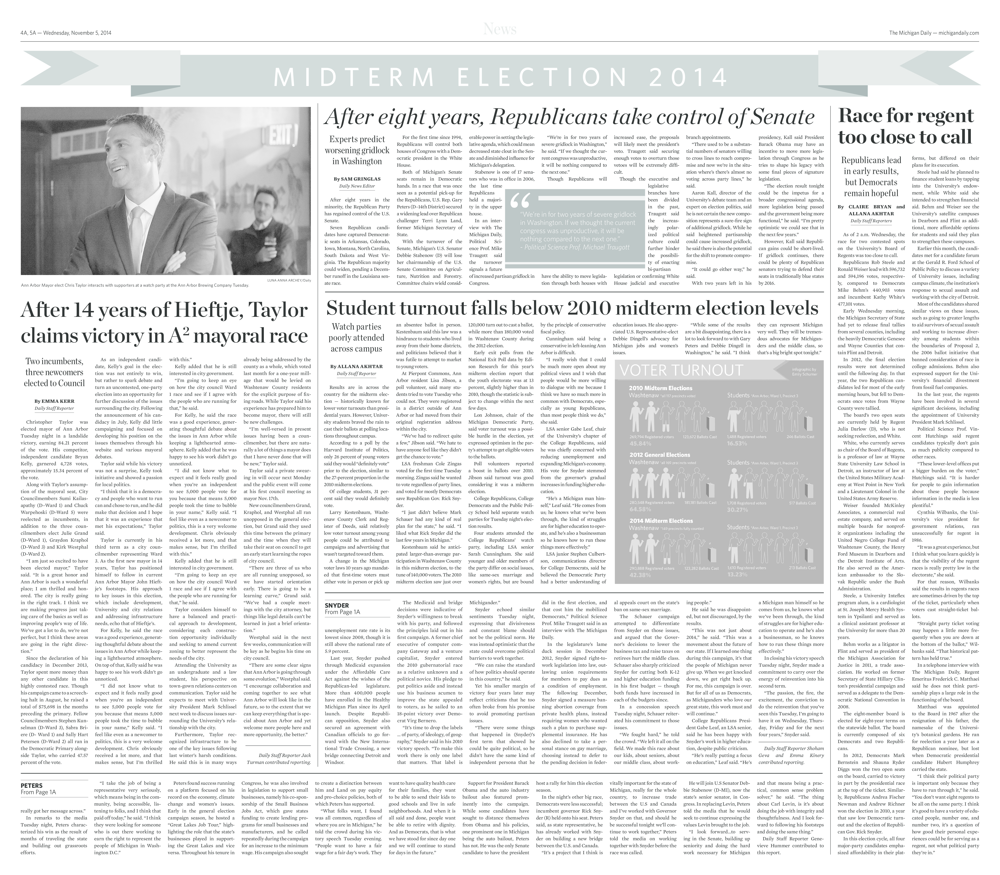

4A, 5A — Wednesday, November 5, 2014

The Michigan Daily — michigandaily.com

 

 

LUNA ANNA ARCHEY/Daily

Ann Arbor Mayor elect Chris Taylor interacts with supporters at a watch party at the Ann Arbor Brewing Company Tuesday.

After eight years, Republicans take control of Senate

Experts predict
worsening gridlock
in Washington

By SAM GRINGLAS
Daily News Editor

After eight years in the
minority, the Republican Party
has regained control of the U.S.
Senate.

Seven Republican  candi-
dates have captured Democrat-
ic seats in Arkansas, Colorado,
Towa, Montana, North Carolina,
South Dakota and West Vir-
ginia. The Republican majority
could widen, pending a Decem-
ber runoff in the Louisiana sen-
ate race.

For the first time since 1994,
Republicans will control both
houses of Congress with a Dem-
ocratic president in the White
House.

Both of Michigan’s Senate
seats remain in Democratic
hands. In a race that was once
seen as a potential pick-up for
the Republicans, U.S. Rep. Gary
Pete

In [28]:
display(img)
print(text)

In [29]:
#find the bounding boxes for all the faces from every page and extract them
for img_name in parsed_img_src.keys():
    open_cv_image = np.array(parsed_img_src[img_name]['pil_img']) 
    img_g = cv.cvtColor(open_cv_image, cv.COLOR_BGR2GRAY)
    faces_bounding_boxes = face_cascade.detectMultiScale(img_g, 1.3, 5)
    parsed_img_src[img_name]['faces'] = []
    
    for x,y,w,h in faces_bounding_boxes:
        face = parsed_img_src[img_name]['pil_img'].crop((x,y,x+w,y+h))
        parsed_img_src[img_name]['faces'].append(face)

In [30]:
#create thumbnails
for img_name in parsed_img_src.keys():
    for face in parsed_img_src[img_name]['faces']:
        face.thumbnail((100,100),Image.ANTIALIAS)

In [35]:

#search the keyword in every page's text and return the faces
def search(keyword):
    for img_name in parsed_img_src:
        if (keyword in parsed_img_src[img_name]['text']):
            if(len(parsed_img_src[img_name]['faces']) != 0):
                print("Result found in file {}".format(img_name))
                h = math.ceil(len(parsed_img_src[img_name]['faces'])/5)
                contact_sheet=Image.new('RGB',(500, 100*h))
                xc = 0
                yc = 0
                for img in parsed_img_src[img_name]['faces']:
                    contact_sheet.paste(img, (xc, yc))
                    if xc + 100 == contact_sheet.width:
                        xc = 0
                        yc += 100
                    else:
                        xc += 100
                        
                display(contact_sheet)
            else:
                print("Result found in file {} But there were no faces in that file\n\n".format(img_name))
    return

Result found in file a-0.png


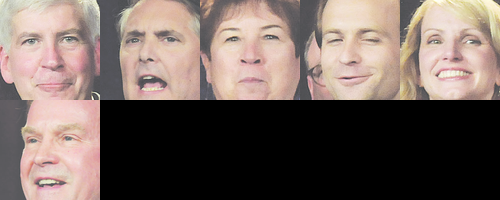

Result found in file a-3.png


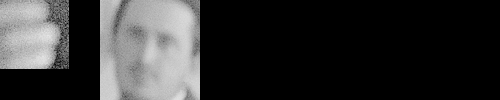

In [36]:
search('Christopher')

Result found in file a-0.png


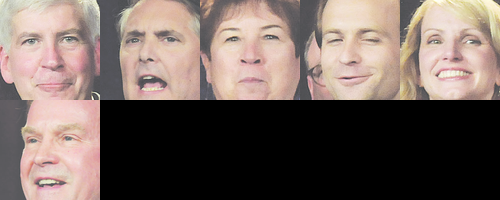

Result found in file a-1.png


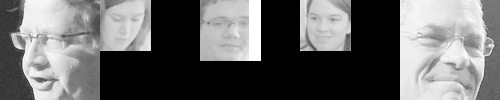

Result found in file a-2.png


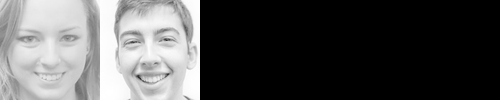

Result found in file a-3.png


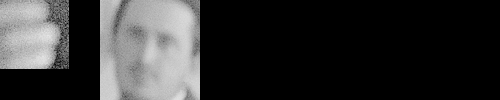

In [33]:
search('Mark')


Result found in file a-2.png


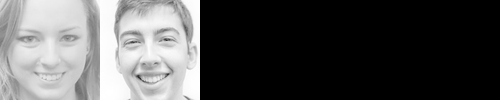

In [34]:
search('pizza')